In [1]:
import os

import h5py
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

In [2]:
import phate

In [3]:
os.chdir('..')
import manifold_methods
import plotting
import mappings
import data_loader

In [4]:
exp_path = '/lustre06/project/6065672/shared/DietNet/1KGB_POP24/1KGP/WGS30X_V1/oldnow/MattsPlace'
fname = '1000G.2504_WGS30x.GSA17k_MHI.intersectGSA.miss10perc.maf0.05.pruned.autosomes.noHLA.phased_imputed_V1.hdf5'

In [5]:
with h5py.File(os.path.join(exp_path, fname), 'r') as hf:
    #model_attrs = hf['gradients'][:]
    #print('loaded gradient of fc1 w.r.t. input from {}'.format(attr_fc1_saliency_name))
    inputs = hf['inputs'][:]
    class_label_names = hf['class_label_names'][:]
    class_labels = hf['class_labels'][:]
    samples = hf['samples'][:]
    snp_names = hf['snp_names'][:]

In [6]:
label_with_names = [str(class_label_names[y])[2:-1] for y in class_labels]

In [7]:
label_with_superpop_names = np.zeros_like(label_with_names)
for label in mappings.super_pops_1000G:
    index = pd.DataFrame(label_with_names).isin(mappings.super_pops_1000G[label]).values.flatten()
    label_with_superpop_names[index] = label

In [8]:
def plot_embeddings_1000G_labels(emb, labels, palette, label_order, ax):
    
    sns.scatterplot(x=emb[:,0],
                    y=emb[:,1],
                    ax=ax,
                    palette=palette,
                    hue_order=label_order,
                    hue=pd.Categorical(labels))
    ax.legend(bbox_to_anchor=(1.1, 1.05), loc='upper left')

    for label in np.unique(labels):
        index = label == labels
        mean_pos = emb[index,:2].mean(0)
        ax.text(x=mean_pos[0], 
                y=mean_pos[1], 
                s=label)

In [13]:
import sklearn
pca_obj = sklearn.decomposition.PCA(n_components=100, random_state=42)
pca_input = pca_obj.fit_transform(inputs)

In [23]:
# initial 2D phate embedding
phate_operator42_2d = phate.PHATE(random_state=42, 
                                  n_components=2, 
                                  knn=5, 
                                  n_pca=None,
                                  decay=60,
                                  t=5)
phate_operator42_2d.fit(pca_input)
phate_emb42_2d = phate_operator42_2d.transform()

Running PHATE on 2322 observations and 100 variables.
Calculating graph and diffusion operator...
  Calculating KNN search...
  Calculated KNN search in 0.32 seconds.
  Calculating affinities...
  Calculated affinities in 0.01 seconds.
Calculated graph and diffusion operator in 0.34 seconds.
Calculating landmark operator...
  Calculating SVD...
  Calculated SVD in 0.11 seconds.
  Calculating KMeans...
  Calculated KMeans in 4.14 seconds.
Calculated landmark operator in 4.80 seconds.
Calculating diffusion potential...
Calculated diffusion potential in 0.64 seconds.
Calculating metric MDS...
Calculated metric MDS in 2.78 seconds.


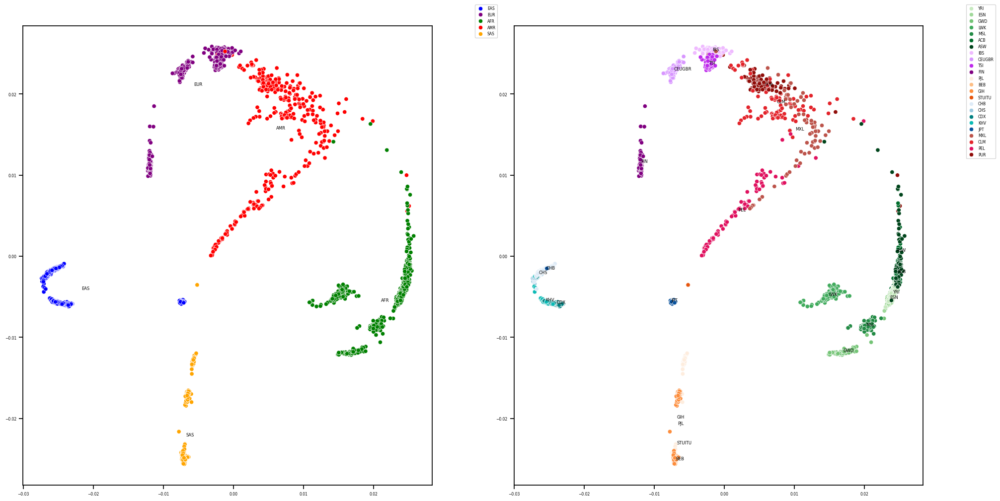

In [24]:
fig, ax = plt.subplots(ncols=2, figsize=(20,10))
plot_embeddings_1000G_labels(phate_emb42_2d, 
                             np.array(label_with_superpop_names), 
                             mappings.pop_pallette_1000G_coarse,
                             mappings.label_order_1000G_coarse,
                             ax[0])
plot_embeddings_1000G_labels(phate_emb42_2d, 
                             np.array(label_with_names),
                             mappings.pop_pallette_1000G_fine,
                             mappings.label_order_1000G_fine,
                             ax[1])
plt.tight_layout()

## PHATE Defaults

Running PHATE on 2322 observations and 229986 variables.
Calculating graph and diffusion operator...
  Calculating PCA...
  Calculated PCA in 56.89 seconds.
  Calculating KNN search...
  Calculated KNN search in 0.33 seconds.
  Calculating affinities...
  Calculated affinities in 0.02 seconds.
Calculated graph and diffusion operator in 57.24 seconds.
Calculating landmark operator...
  Calculating SVD...
  Calculated SVD in 0.12 seconds.
  Calculating KMeans...
  Calculated KMeans in 1.19 seconds.
Calculated landmark operator in 1.86 seconds.
Calculating optimal t...
  Automatically selected t = 9
Calculated optimal t in 1.95 seconds.


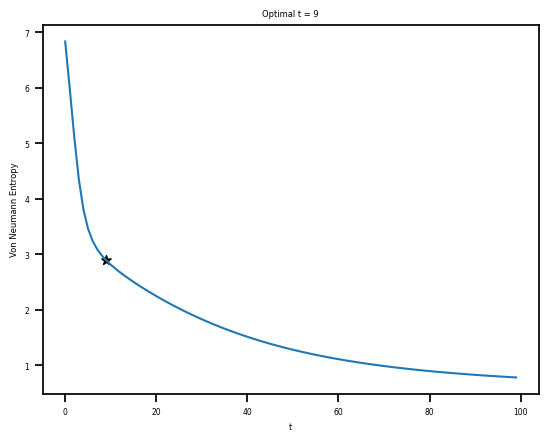

Calculating diffusion potential...
Calculated diffusion potential in 0.88 seconds.
Calculating metric MDS...


/lustre06/project/6065672/sciclun4/Envs/phate_env/lib/python3.11/site-packages/sklearn/manifold/_mds.py:298: FutureWarning: The default value of `normalized_stress` will change to `'auto'` in version 1.4. To suppress this warning, manually set the value of `normalized_stress`.
  warnings.warn(


Calculated metric MDS in 20.39 seconds.


In [29]:
# initial phate embedding
phate_operator42 = phate.PHATE(random_state=42, n_components=3, knn=5, decay=60)
phate_operator42.fit(inputs)
phate_emb42 = phate_operator42.transform(plot_optimal_t=True)

<Axes3D: xlabel='PHATE1', ylabel='PHATE2', zlabel='PHATE3'>

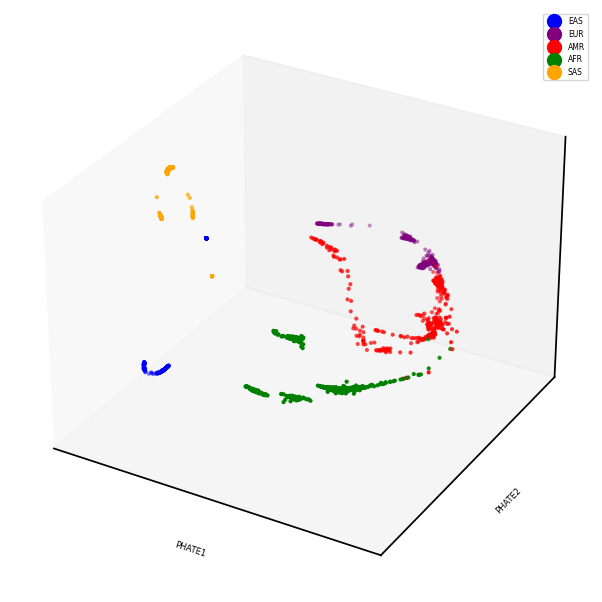

In [30]:
import scprep
scprep.plot.scatter3d(phate_emb42, 
                      c=np.array(label_with_superpop_names), 
                      figsize=(8,6),
                      cmap=mappings.pop_pallette_1000G_coarse,
                      ticks=False, label_prefix="PHATE")

In [31]:
scprep.plot.rotate_scatter3d(phate_emb42, 
                              c=np.array(label_with_superpop_names), 
                              figsize=(8,6),
                              cmap=mappings.pop_pallette_1000G_coarse,
                              ticks=False, label_prefix="PHATE")

<Axes3D: xlabel='PHATE1', ylabel='PHATE2', zlabel='PHATE3'>

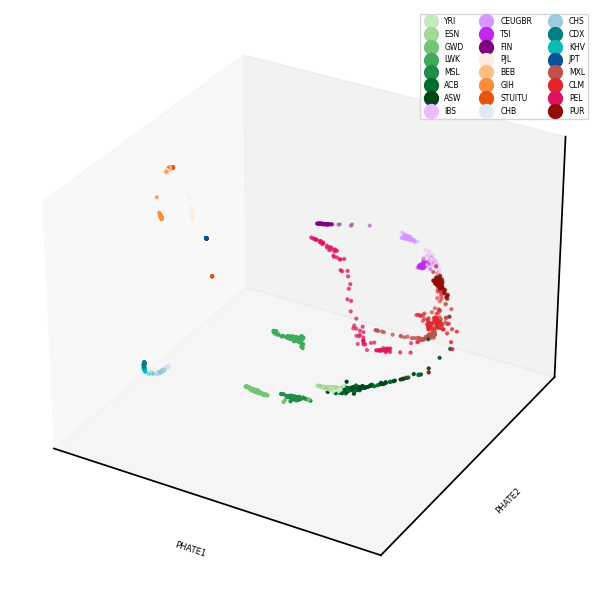

In [32]:
scprep.plot.scatter3d(phate_emb42, 
                      c=np.array(label_with_names), 
                      figsize=(8,6),
                      cmap=mappings.pop_pallette_1000G_fine,
                      ticks=False, label_prefix="PHATE")

In [33]:
scprep.plot.rotate_scatter3d(phate_emb42, 
                              c=np.array(label_with_names), 
                              figsize=(8,6),
                              cmap=mappings.pop_pallette_1000G_fine,
                              ticks=False, label_prefix="PHATE")

In [34]:
sample_ids = pd.read_csv('notebooks/MyAdmix/output_ids.txt', sep=' ', header=None)
admix_ratios = pd.read_csv('notebooks/MyAdmix/AMR_ACB_ASW.3.Q', sep=' ', header=None)

In [35]:
admix_labels_custom = np.zeros([len(label_with_names), 3])

In [36]:
admix_df = pd.concat([admix_ratios, sample_ids], axis=1)
admix_df.columns = ['admix 1', 'admix 2', 'admix 3' , 'sample id']

In [37]:
labels2 = np.array([sample.decode("utf-8") for sample in samples])
matching_indices = np.array([np.where(admix_df['sample id'][j] == labels2)[0][0] if len(np.where(admix_df['sample id'][j] == labels2)[0]) > 0 else -1 for j in range(len(admix_df))])

In [38]:
for i, idx in enumerate(matching_indices):
    if idx != -1:
        admix_labels_custom[idx] = admix_df.iloc[i].values[:3]

In [39]:
admix_labels_custom2 = admix_labels_custom
admix_labels_custom2[label_with_superpop_names == 'EUR', 2] = 1
admix_labels_custom2[label_with_superpop_names == 'AFR', 0] = 1

In [40]:
#"African ancestry (%)"
scprep.plot.rotate_scatter3d(phate_emb42, 
                              c=admix_labels_custom2[:,0], 
                              figsize=(8,6),
                              cmap='Reds',
                              ticks=False, label_prefix="PHATE")

In [41]:
#"Amerindigenous ancestry (%)"
scprep.plot.rotate_scatter3d(phate_emb42, 
                              c=admix_labels_custom2[:,1], 
                              figsize=(8,6),
                              cmap='Reds',
                              ticks=False, label_prefix="PHATE")

In [42]:
#"European ancestry (%)"
scprep.plot.rotate_scatter3d(phate_emb42, 
                              c=admix_labels_custom2[:,2], 
                              figsize=(8,6),
                              cmap='Reds',
                              ticks=False, label_prefix="PHATE")